# Practical Application Assignment Part II -- Evaluation 

#### Loading Packages and Data

In [82]:
import pandas as pd 
import numpy as np
import statistics
import seaborn as sns
import plotly.express as px
from plotly.offline import plot, iplot, init_notebook_mode
import plotly.graph_objs as go
pio.write_html(fig, file='figure.html', auto_open=True)
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.graphics.tsaplots as tsaplots
import statsmodels.tsa.arima_process as arima_process 

from matplotlib.pyplot import figure
from matplotlib import pyplot
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [83]:
pd.set_option("display.max_columns", None)
df = pd.read_csv("/Users/lois/Desktop/ML/Module 11/practical_application_II_starter/data/vehicles.csv")
df.head(3)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl


#### Data Cleaning and Setup
Same process as in Part I without categorical feature encoding

In [84]:
df.dropna(subset=['year', 'manufacturer', 'model', 'fuel', 'odometer', 'title_status', 'transmission'], inplace = True) 

In [85]:
df["condition"].fillna(df["condition"].mode().to_string(), inplace = True)
df["cylinders"].fillna(df["cylinders"].mode().to_string(), inplace = True)
df["drive"].fillna(df["drive"].mode().to_string(), inplace = True)
df["size"].fillna(df["size"].mode().to_string(), inplace = True)
df["type"].fillna(df["type"].mode().to_string(), inplace = True)
df["paint_color"].fillna(df["paint_color"].mode().to_string(), inplace = True)

#df.isna().sum()

In [86]:
df = df[df["size"] != '0    4']
df["size"].replace({"0    full-size" : 4, "full-size" : 4, "mid-size" : 3, "compact" : 2, "sub-compact" : 1}, inplace = True)
#df["size"].unique()

In [87]:
df["paint_color"].replace({"0    white" : "white"}, inplace = True)

In [88]:
df = df[df["condition"] != '0    good']
#df["condition"].replace({"new" : 6, "excellent" : 5, "like new" : 4, "good" : 3, "fair" : 2, "salvage" : 1}, inplace = True)

#converting values to Int
#df["condition"] = df["condition"].astype(int)

In [89]:
df = df[df["cylinders"] != "0    6"]
df["cylinders"].replace({"8 cylinders" : 8, "6 cylinders" : 6, "0    6 cylinders" : 6, \
                         "5 cylinders" : 5, "4 cylinders" : 4, "10 cylinders" : 10, \
                         "3 cylinders" : 3, "12 cylinders" : 12, "other" : 6}, inplace = True)



In [90]:
df["title_status"].replace({"clean" : 6, "lien" : 5, "rebuilt" : 4, "missing" : 3, "salvage" : 2, "parts only" : 1}, inplace = True)

In [91]:
df = df[(df["price"] >= 150) & (df["price"] <= 70000)]

In [92]:
df = df.convert_dtypes()

### Evaluation of Top Features

After assessing the models, we found the features most significant in predicting price to be model, year, odometer, and condition. In following our business objective to identify the attributes that will most effectively raise the price of a used car, we will now proceed to examine these four features and their relationships with price in depth.

#### Overview of Price
This histogram shows that most common car price is around 5,000 dollars, and most used cars cost under 10,000 dollars. 

[Text(0.5, 1.0, 'Histogram of Prices')]

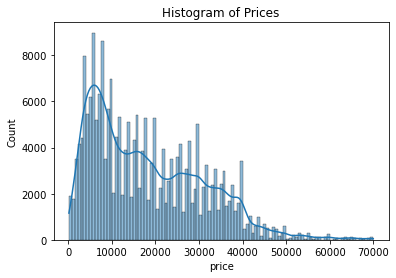

In [93]:
#histogram of price 
sns.histplot(data = df, x = "price", stat = "count", kde = True).set(title = "Histogram of Prices")

#### Price Statistics
The mean price of used cars is 18191 dollars, and the median price is 11589 dollars. 27500 dollars is at the 75th percentile, and 7250 dollars is at the 25th percentile. To aid in further analysis, an additional column called price_cat with three unique values -- Low, Med, and High -- that groups car prices into three categories is added to the dataframe. 

In [94]:
df.price.describe()

count    220800.000000
mean      18191.092695
std       12817.081021
min         150.000000
25%        7250.000000
50%       15589.000000
75%       27500.000000
max       70000.000000
Name: price, dtype: float64

In [95]:
#adding a quartile column that corresponds corresponds to low, medium, and high price

quartiles = pd.qcut(df['price'], 3, labels = ["Low", "Med", "High"])
df = df.assign(price_cat = quartiles.values)
df.head(3)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state,price_cat
27,7316814884,auburn,33590,2014,gmc,sierra 1500 crew cab slt,good,8,gas,57923,6,other,3GTP1VEC4EG551563,0 4wd,4,pickup,white,al,High
28,7316814758,auburn,22590,2010,chevrolet,silverado 1500,good,8,gas,71229,6,other,1GCSCSE06AZ123805,0 4wd,4,pickup,blue,al,Med
29,7316814989,auburn,39590,2020,chevrolet,silverado 1500 crew,good,8,gas,19160,6,other,3GCPWCED5LG130317,0 4wd,4,pickup,red,al,High


#### Model Overview
Because there are 15161 unique models in the dataset, we will be focusing on models that have at least 1000 records, or the top 12 models. 

In [96]:
#making a dataframe of popular models 

pop_models_df = df["model"].value_counts(ascending = False).to_frame().reset_index()
pop_models_df = pop_models_df[pop_models_df["model"] > 1000].rename({"index" : "Model", "model" : "Count"}, axis = 1)
pop_models_df

,Model,Count
0,f-150,2877
1,silverado 1500,2333
2,1500,1507
3,camry,1468
4,accord,1402
5,wrangler,1327
6,civic,1295
7,altima,1224
8,silverado,1175
9,tacoma,1166


In [97]:
#array of most popular models
top_12 = pop_models_df["Model"].unique()

#df with only records where model is in top_12
pop_models = df["model"].isin(top_12)
df_top12 = df[pop_models]

The following histogram shows the distribution of price for each of the top models. 
- Models that tend to be priced high are the 1500, silverado 1500, and the f-150
- Models that tend to be priced medium are the tacoma, wrangler, silverado, and mustang
- Models that tend to be priced low are the camry, altima, accord, escape, and civic

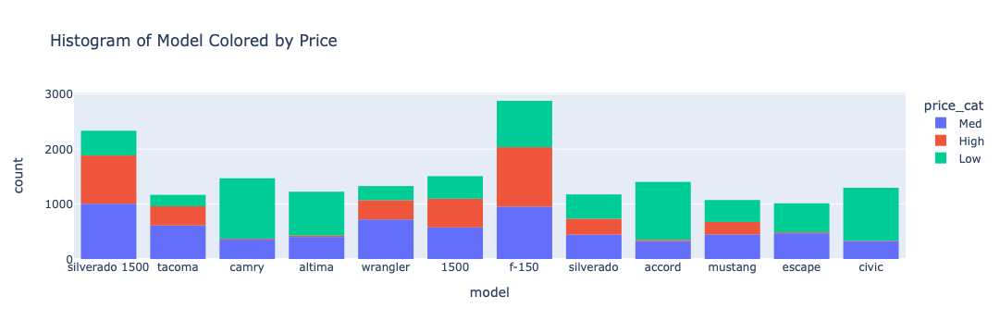

In [98]:
#histogram of top models colored by price 
fig = px.histogram(df_top12, x = "model", color = "price_cat", title = "Histogram of Model Colored by Price")
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

The following histogram shows the distribution of models for each price cateogory. 
- Models that largely comprise the low price group are the camry, accord, f-150, altima, and civic
- Models that largely comprise the medium price group are the silverado 1500, f-150, and wrangler
- Models that largely comprise the high price group are the Silverado 1500, f-150, and 1500. 

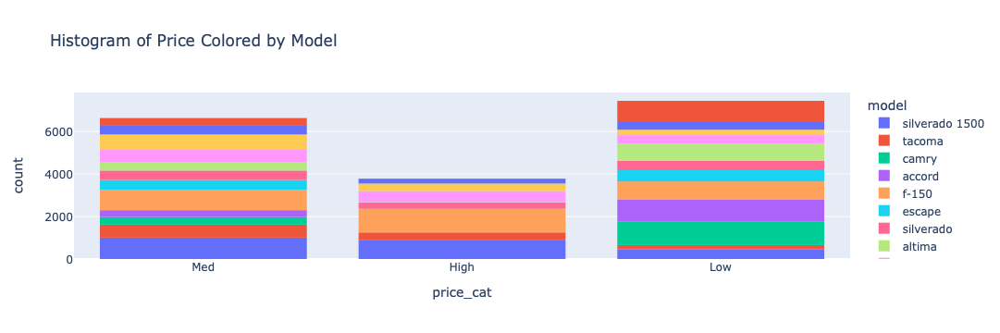

In [99]:
fig = px.histogram(df_top12, x = "price_cat", color = "model", title = "Histogram of Price Colored by Model")
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

#### Year
The following histogram shows the distribution of year in this dataset. Because there are very few records of cars with years before 1990, we will be focusing on the year range between 1990-2020.

[Text(0.5, 1.0, 'Distribution of Year')]

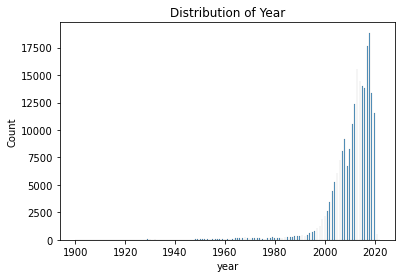

In [100]:
sns.histplot(data = df, x = "year").set(title = "Distribution of Year")

The following histogram shows the distribution of year colored by price. The majority of cars between the years 1990-2010 are low price, while the majority of cars between 2011-2016 are medium price. 2017 cars seem to be split between medium and high price, and cars after 2018 are mostly priced high. 

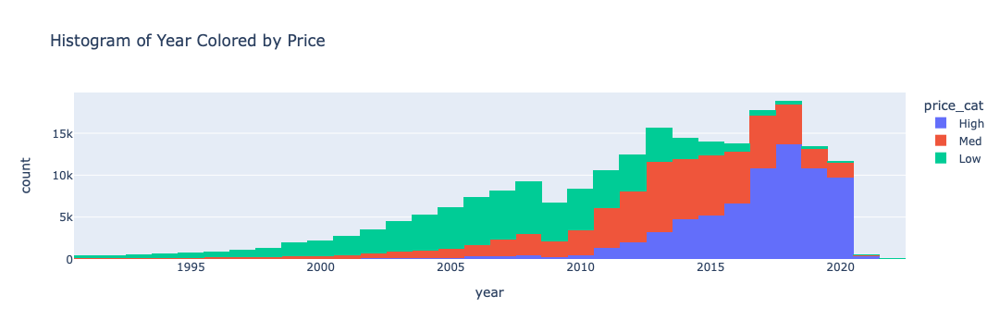

In [101]:
fig = px.histogram(df[df["year"] > 1990], x = "year", title = "Histogram of Year Colored by Price", color = "price_cat", labels = {"Year", "Count"})
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

The following histogram shows the distribution of year for each category of price:
- The years that dominate the low price group (at least 5000 records) are 2006, 2007, and 2008
- The years that dominate the medium price group (at least 6000 records) are 2012, 2013, 2014, 2015, 2016, and 2017
- The years that dominate the high price group (at least 9,700 records) are 2017, 2018, 2019, and 2020 

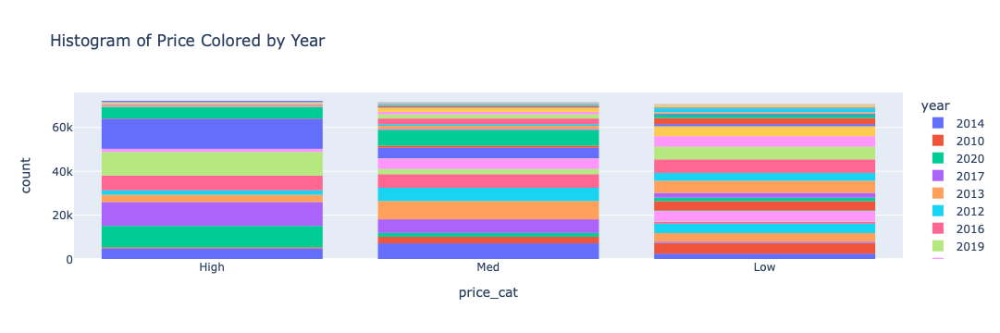

In [102]:
fig = px.histogram(df[df["year"] > 1990], x = "price_cat", title = "Histogram of Price Colored by Year", color = "year", labels = {"Year", "Count"})
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

#### Odometer
The following histogram gives the distribution of odometer values. Because there are very few records of odometer values over 260,000, we will focus our analysis on values under this threshold. 

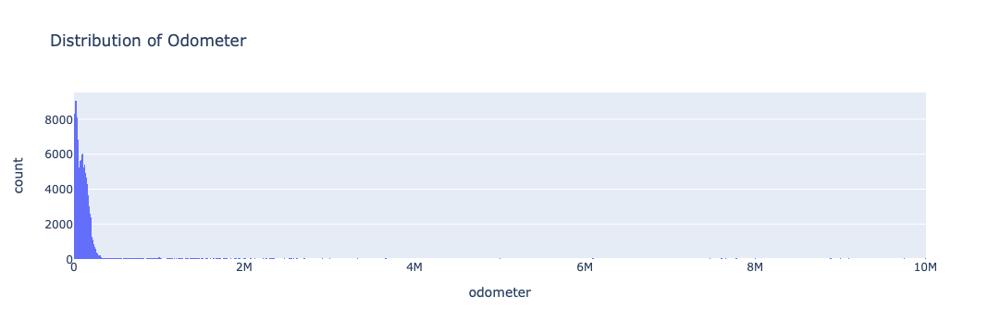

In [103]:
fig = px.histogram(df, x = "odometer", title = "Distribution of Odometer")
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

The following histogram shows the distribution of odometer readings colored by price. We can see that odometer readings are negatively correlated with price, with lower odometer values associated with higher cost 
- Odometer readings under 50,000 are largely priced high
- Odometer readings between 50,000-110,000 are largely medium priced
- Odometer readings above 110,000 are largely priced low

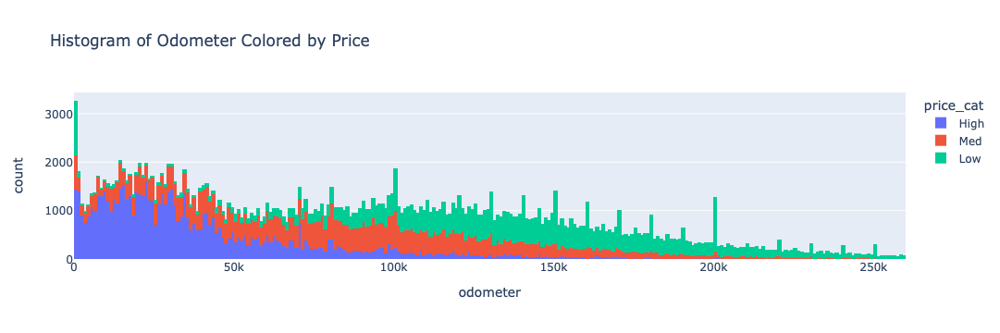

In [104]:
fig = px.histogram(df[df["odometer"] < 260000], x = "odometer", title = "Histogram of Odometer Colored by Price", color = "price_cat", labels = {"Year", "Count"})
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

#### Condition
The following histogram shows the used car condition colored by price group
- Cars in good condition are mostly priced high and medium 
- Cars in excellent condition are mostly priced medium and low
- Cars in like-new condition are split evenly between the three price groups
- Cars in new, fair, and salvage condition are mostly priced low
- Interestingly, cars in "new" condition are largely priced low, but because this is a used car dataset this column can likely be ignored

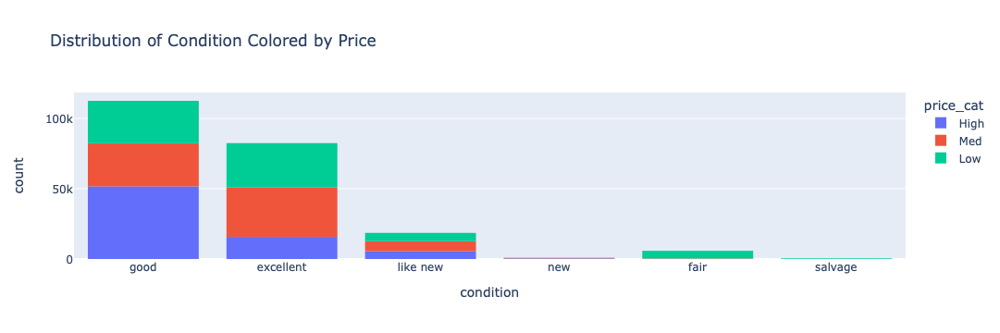

In [105]:
fig = px.histogram(df, x = "condition", title = "Distribution of Condition Colored by Price", color = "price_cat", labels = {"Condition", "Count"})
fig.show()
pio.write_html(fig, file='figure.html', auto_open=True)

### Summary 

The four most important features in predicting the price of a used car are model, condition, and year. In essence, customers value newer (post-2017) cars with low odometer readings in medium to good condition. Further analysis of these columns reveal the following:

Car Models 
- The 1500, Silverado 1500, and f-150 models are priced the highest
- The Camry, Altima, Civic, and Accord models are priced the lowest 

Year  
- Newer cars (by year) are consistently asociated with higher prices 
- 2006-2008 cars dominate the low price group
- 2012-2017 cars dominate the medium price group 
- 2017-2020 cars dominate the high price group  
- 2017 cars are nearly evenly split between the medium and high price groups 

Odometer 

- Lower odometer readings are consistenly associated with higher prices 
- High priced cars tend to have odometer readings below 50,000
- Medium priced cars tend to have odometer readings between 50,000-110,000
- Low priced cars tend to have odometer readings above 110,000

Condition
- Cars in better conditions are consistently associated with higher prices
- Cars in good and medium condition are mostly priced higher 
- Cars in excellent condition are mostly medium and low priced 
- Cars in fair and salvage condition are mostly low priced 
- Cars in like-new condition are split evenly between the three price groups 

### Next Steps and Recommendations

- Customers value recent models, so **it is recommended that acquiring recent cars (post 2017) is prioritised, while acquiring cars 2008 and prior should not be a priority**
- **Cars 2017 and later can be listed at higher prices, while cars older than 2008 should be more affordably priced**  
- Additionally, lower odometer readings are valued, and **efforts to list cars with odometer readings below 50,000 are recommended**
- **Cars with odometer readings above 110,000 should not be prioritised, and when listed, they should be more affordably priced**
- Cars in medium to good condition are consistently highly valued, while fair and salvage conditions are not. As such, **Listing cars in good, medium, and like-new condition is recommended**
- **Listing cars in salvage and fair condition should not be prioritised, and when listed, they should be affordably priced** 
- **The 1500, Silverado 1500, and f-150 models are most valued, so they can be listed at higher prices**
- **The Camry, Altima, Civic, and Accord models are least valued, so they should be listed at more affordable prices**